In [1]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
from tqdm import tqdm

np.random.seed(42)
tqdm.pandas()

**Загрузка данных:**

In [2]:
df = pd.read_csv("kc_house_data.csv", parse_dates=True).progress_apply(lambda x: x)

100%|██████████| 21/21 [00:00<00:00, 5250.38it/s]


In [3]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


**Данные содержат следующие колонки:**

In [4]:
df.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype='object')

id: Уникальный идентификатор дома.

date: Дата продажи дома.

price: Цена продажи дома.

bedrooms: Количество спален в доме.

bathrooms: Количество ванных комнат в доме.

sqft_living: Площадь жилой площади в квадратных футах.

sqft_lot: Площадь участка в квадратных футах.

floors: Количество этажей в доме.

waterfront: Признак, указывающий на наличие видовой части (1, если есть, иначе 0).

view: Оценка видовой части дома.

condition: Оценка общего состояния дома.

grade: Оценка качества строительства и отделки дома.

sqft_above: Площадь верхних этажей дома в квадратных футах.

sqft_basement: Площадь подвальной части дома в квадратных футах.

yr_built: Год постройки дома.

yr_renovated: Год последнего ремонта дома.

zipcode: Почтовый индекс дома.

lat: Широта дома.

long: Долгота дома.

sqft_living15: Средняя площадь жилой площади по соседним 15 домам.

sqft_lot15: Средняя площадь участка по соседним 15 домам.

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

**В данных нет пропусков. Посмотрим на описательные статистики:**

In [6]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,21613.0,4.580302e+09,2.876566e+09,1.000102e+06,2.123049e+09,3.904930e+09,7.308900e+09,9.900000e+09
price,21613.0,5.400881e+05,3.671272e+05,7.500000e+04,3.219500e+05,4.500000e+05,6.450000e+05,7.700000e+06
bedrooms,21613.0,3.370842e+00,9.300618e-01,0.000000e+00,3.000000e+00,3.000000e+00,4.000000e+00,3.300000e+01
bathrooms,21613.0,2.114757e+00,7.701632e-01,0.000000e+00,1.750000e+00,2.250000e+00,2.500000e+00,8.000000e+00
sqft_living,21613.0,2.079900e+03,9.184409e+02,2.900000e+02,1.427000e+03,1.910000e+03,2.550000e+03,1.354000e+04
sqft_lot,21613.0,1.510697e+04,4.142051e+04,5.200000e+02,5.040000e+03,7.618000e+03,1.068800e+04,1.651359e+06
floors,21613.0,1.494309e+00,5.399889e-01,1.000000e+00,1.000000e+00,1.500000e+00,2.000000e+00,3.500000e+00
waterfront,21613.0,7.541757e-03,8.651720e-02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
view,21613.0,2.343034e-01,7.663176e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.000000e+00
condition,21613.0,3.409430e+00,6.507430e-01,1.000000e+00,3.000000e+00,3.000000e+00,4.000000e+00,5.000000e+00


**id - первичный ключ, не несет полезных данных.**

In [7]:
df.drop("id", axis=1, inplace=True)

**Приведем дату в нормальный вид**

In [8]:
from datetime import datetime

df.date = df.date.apply(lambda x: datetime.strptime(x, '%Y%m%dT%H%M%S').strftime('%Y-%m-%d %H:%M:%S'))

In [9]:
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,2014-10-13 00:00:00,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,2014-12-09 00:00:00,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,2015-02-25 00:00:00,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2014-12-09 00:00:00,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,2015-02-18 00:00:00,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


**Можно сконструировать признак, который будет общей площадью дома**

In [10]:
df["square"] = df.sqft_living + df.sqft_above + df.sqft_basement

**Век постройки дома:**

In [11]:
df["cent"] = df.yr_built.apply(lambda x: 20 if x < 2000 else 21)

**Визуализируем дома на карте:**

In [12]:
from urllib.request import urlopen
import plotly.express as px
import json

with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)


df_unemp = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                       dtype={"fips": str})

fig = px.choropleth_mapbox(df_unemp, geojson=counties, locations='fips', color='unemp',
                            color_continuous_scale="Viridis",
                            range_color=(0, 12),
                            mapbox_style="carto-positron",
                            zoom=3, center={"lat": 37.0902, "lon": -95.7129},
                            opacity=0.5,
                            labels={'unemp': 'unemployment rate'}
                           )

fig.add_scattermapbox(lat=df['lat'], lon=df['long'], mode='markers', 
                      marker={'size': 10, 'color': 'red', 'opacity': 0.8}, 
                      name='Houses')

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

**Сконструируем признак отвечающий за расстояние до примерного центра Сиэтла**

In [13]:
from math import radians, sin, cos, sqrt, atan2

def distance(lat1, lon1, lat2, lon2):
    lat1_rad, lon1_rad, lat2_rad, lon2_rad = map(radians, [lat1, lon1, lat2, lon2])

    R = 6371.0

    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad

    a = sin(dlat / 2)**2 + cos(lat1_rad) * cos(lat2_rad) * sin(dlon / 2)**2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))

    distance = R * c

    return distance

seattle_center_lat = 47.6062
seattle_center_lon = -122.3321

df['distance_to_seattle_center'] = df.apply(lambda row: \
                                            distance(row['lat'], row['long'], seattle_center_lat, \
                                                               seattle_center_lon), axis=1)

**Можно создать ещё один признак - отношение числа ванных комнат к числу спален**

In [14]:
df["baths_res_bedr"] = np.where(df.bedrooms != 0, df.bathrooms / df.bedrooms, 0)

**Последний признак - средняя площадь 15 ближайших домов к каждому дому.**

In [15]:
from sklearn.neighbors import NearestNeighbors

In [16]:
nn = NearestNeighbors(n_neighbors=16, metric='euclidean')  
nn.fit(df[['lat', 'long']])

distances, indices = nn.kneighbors(df[['lat', 'long']], n_neighbors=16)

avg_neighbor_area = []
for neighbor_indices in indices[:, 1:]:  
    neighbor_area = df.loc[neighbor_indices, 'square'].mean() 
    avg_neighbor_area.append(neighbor_area)

df['avg_neighbor_area'] = avg_neighbor_area

df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,zipcode,lat,long,sqft_living15,sqft_lot15,square,cent,distance_to_seattle_center,baths_res_bedr,avg_neighbor_area
0,2014-10-13 00:00:00,221900.0,3,1.00,1180,5650,1.0,0,0,3,...,98178,47.5112,-122.257,1340,5650,2360,20,11.972687,0.333333,3932.266667
1,2014-12-09 00:00:00,538000.0,3,2.25,2570,7242,2.0,0,0,3,...,98125,47.7210,-122.319,1690,7639,5140,20,12.802819,0.750000,2745.733333
2,2015-02-25 00:00:00,180000.0,2,1.00,770,10000,1.0,0,0,3,...,98028,47.7379,-122.233,2720,8062,1540,20,16.416960,0.500000,4566.800000
3,2014-12-09 00:00:00,604000.0,4,3.00,1960,5000,1.0,0,0,5,...,98136,47.5208,-122.393,1360,5000,3920,20,10.538233,0.750000,3936.000000
4,2015-02-18 00:00:00,510000.0,3,2.00,1680,8080,1.0,0,0,3,...,98074,47.6168,-122.045,1800,7503,3360,20,21.553979,0.666667,3877.333333


In [17]:
df.tail()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,zipcode,lat,long,sqft_living15,sqft_lot15,square,cent,distance_to_seattle_center,baths_res_bedr,avg_neighbor_area
21608,2014-05-21 00:00:00,360000.0,3,2.50,1530,1131,3.0,0,0,3,...,98103,47.6993,-122.346,1530,1509,3060,21,10.404472,0.833333,2624.000000
21609,2015-02-23 00:00:00,400000.0,4,2.50,2310,5813,2.0,0,0,3,...,98146,47.5107,-122.362,1830,7200,4620,21,10.853552,0.625000,3426.666667
21610,2014-06-23 00:00:00,402101.0,2,0.75,1020,1350,2.0,0,0,3,...,98144,47.5944,-122.299,1020,2007,2040,21,2.807293,0.375000,2726.666667
21611,2015-01-16 00:00:00,400000.0,3,2.50,1600,2388,2.0,0,0,3,...,98027,47.5345,-122.069,1410,1287,3200,21,21.287500,0.833333,3816.666667
21612,2014-10-15 00:00:00,325000.0,2,0.75,1020,1076,2.0,0,0,3,...,98144,47.5941,-122.299,1020,1357,2040,21,2.823044,0.375000,2982.666667


**Анализ данных**

Построим гистограммы для колонок

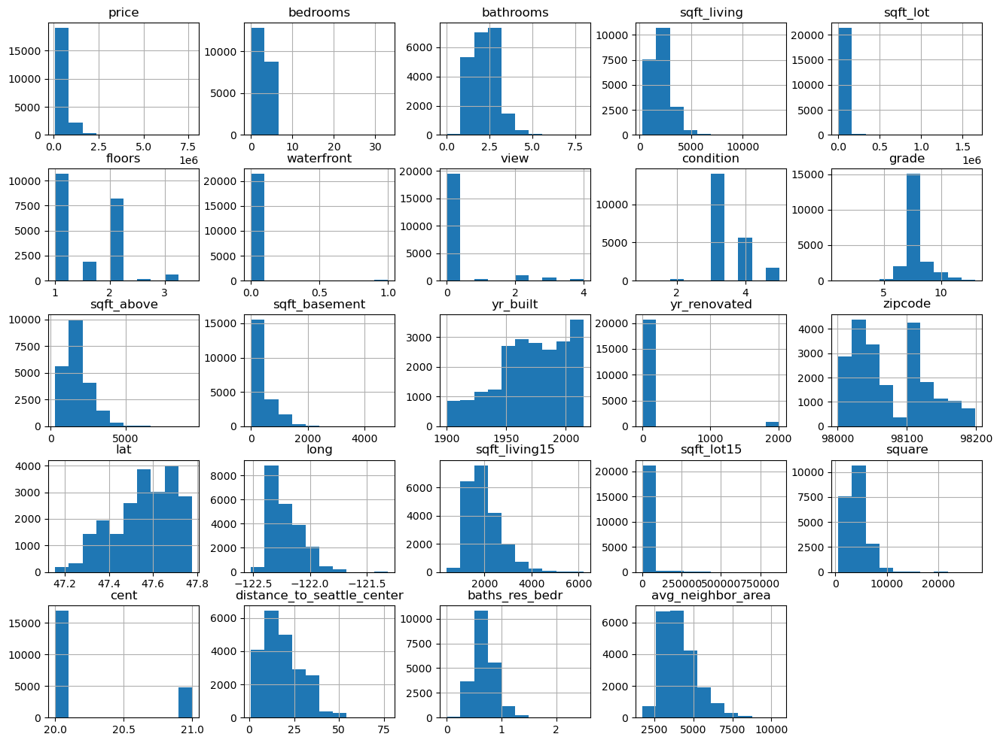

In [18]:
df.drop("date", axis=1).hist(figsize=(16, 12));

interval columns not set, guessing: ['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long', 'sqft_living15', 'sqft_lot15', 'square', 'cent', 'distance_to_seattle_center', 'baths_res_bedr', 'avg_neighbor_area']


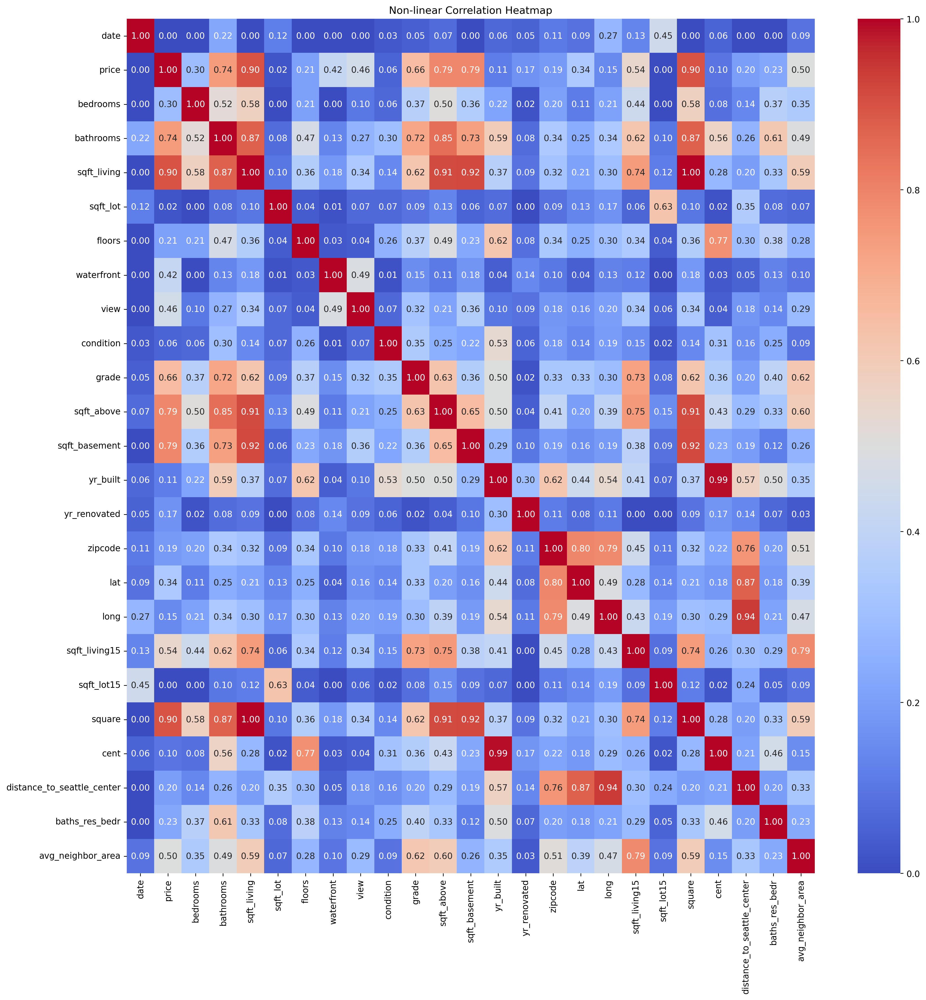

In [19]:
import phik
from phik import phik_matrix

phik_corr_matrix = df.phik_matrix()

plt.figure(figsize=(18, 18), dpi=250)
sns.heatmap(phik_corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Non-linear Correlation Heatmap')
plt.show();

**Признаки, сильно коррелирующие с ценой дома:**

1) Количество ванных комнат

2) Площадь жилой площади

3) Оценка качества строительства и отделки дома

4) Площадь верхних этажей дома

5) Площадь подвальной части дома

6) Общая площадь

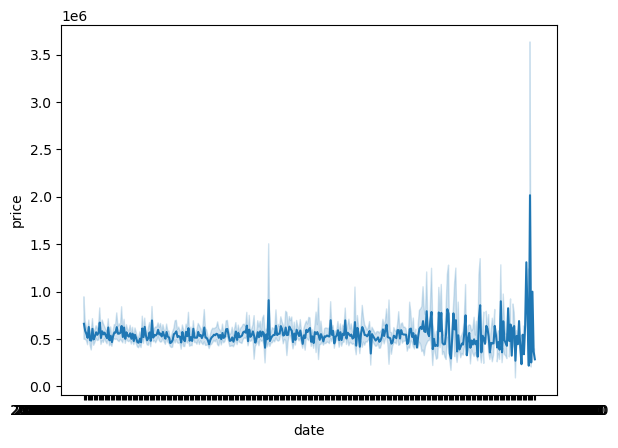

In [20]:
sns.lineplot(data=df, x="date", y="price");

**Можно создать признак времен года по дате:**

In [21]:
df.date = pd.to_datetime(df.date)
df['season'] = df.date.dt.month.map({1: 'winter', 2: 'winter', 3: 'spring', 
                                        4: 'spring', 5: 'spring', 6: 'summer',
                                        7: 'summer', 8: 'summer', 9: 'autumn',
                                        10: 'autumn', 11: 'autumn', 12: 'winter'})
df = pd.get_dummies(df, drop_first=True)

In [22]:
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,sqft_living15,sqft_lot15,square,cent,distance_to_seattle_center,baths_res_bedr,avg_neighbor_area,season_spring,season_summer,season_winter
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,3,...,1340,5650,2360,20,11.972687,0.333333,3932.266667,0,0,0
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,3,...,1690,7639,5140,20,12.802819,0.750000,2745.733333,0,0,1
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,3,...,2720,8062,1540,20,16.416960,0.500000,4566.800000,0,0,1
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,5,...,1360,5000,3920,20,10.538233,0.750000,3936.000000,0,0,1
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,3,...,1800,7503,3360,20,21.553979,0.666667,3877.333333,0,0,1


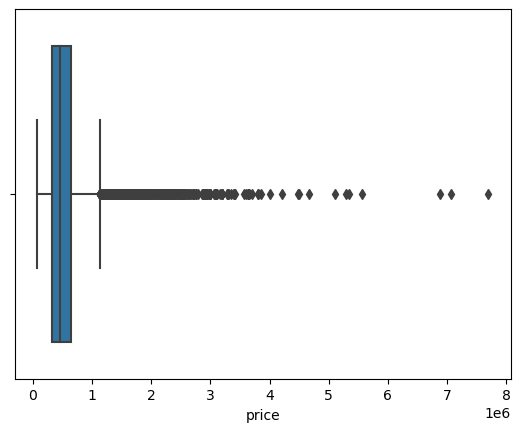

In [23]:
sns.boxplot(x="price", data=df);

**В данных много выбросов**

**Построение модели линейной регресии**

In [24]:
df.set_index('date', inplace=True)

In [25]:
import optuna
import numpy as np
import pandas as pd
from sklearn.linear_model import Lasso
from sklearn.model_selection import cross_val_score, TimeSeriesSplit
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

best_model = None

X = df.drop('price', axis=1)
y = df['price']


def objective(trial):
    alpha = trial.suggest_float('alpha', 0.0, 1.0)

    pipeline = Pipeline([
        ('scaler', StandardScaler()),  
        ('lasso', Lasso(alpha=alpha))  
    ])

    cv = TimeSeriesSplit(n_splits=5)

    cv_scores = cross_val_score(pipeline, X, y, cv=cv, scoring='neg_mean_squared_error')
    print(f"MSE: {np.mean(cv_scores) + np.std(cv_scores)}")
    return np.mean(cv_scores) + np.std(cv_scores)


study = optuna.create_study(direction='minimize')


study.optimize(objective, n_trials=50)

print("Best trial:")
trial = study.best_trial
print("  Value: ", trial.value)
print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

[I 2024-03-20 19:26:18,109] A new study created in memory with name: no-name-231d5069-c366-457e-92e2-f307d7a8ebe5
C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 7156867466719.734, tolerance: 50474681644.64803

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13623968980360.906, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22731212646869.844, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinat

MSE: -32347403819.491535


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727324431844.188, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962561754148.5, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35397240931757.06, tolerance: 238894110833.975

[I 2024-03-20 19:26:19,672] Trial 1 finished with value: -32347771815.12758 and parameters: {'alpha': 0.03726354388187858}. Best is trial 1 with value: -32347771815.12758.
C:\anaconda3\envs\ML_course_st

MSE: -32347771815.12758


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22729176707163.25, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29964959258800.625, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35400065165728.875, tolerance: 238894110833.975

[I 2024-03-20 19:26:20,442] Trial 2 finished with value: -32347597076.38192 and parameters: {'alpha': 0.3395616097395947}. Best is trial 1 with value: -32347771815.12758.
C:\anaconda3\envs\ML_course_s

MSE: -32347597076.38192


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22730910921895.344, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29967203590300.875, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35402707963675.375, tolerance: 238894110833.975

[I 2024-03-20 19:26:21,218] Trial 3 finished with value: -32347432539.47547 and parameters: {'alpha': 0.6242515250952227}. Best is trial 1 with value: -32347771815.12758.
C:\anaconda3\envs\ML_course_

MSE: -32347432539.47547


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22732033018940.312, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29968655540498.438, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35404417190716.875, tolerance: 238894110833.975

[I 2024-03-20 19:26:22,010] Trial 4 finished with value: -32347325590.254765 and parameters: {'alpha': 0.8093217216140074}. Best is trial 1 with value: -32347771815.12758.
C:\anaconda3\envs\ML_course

MSE: -32347325590.254765


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13624366374635.5, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22731814836937.0, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29968373234943.75, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations

MSE: -32347346415.87902


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13623393084735.312, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22730339987862.594, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29966464761073.062, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347486808.522293


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621996522646.844, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22728223868094.5, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29963725980820.0, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iteration

MSE: -32347687093.260735


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22728461553903.562, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29964033627308.625, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35398974912565.75, tolerance: 238894110833.975

[I 2024-03-20 19:26:25,189] Trial 8 finished with value: -32347664664.349533 and parameters: {'alpha': 0.22262908963711792}. Best is trial 1 with value: -32347771815.12758.
C:\anaconda3\envs\ML_course

MSE: -32347664664.349533


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22728037623776.375, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29963484902668.938, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35398328531676.69, tolerance: 238894110833.975

[I 2024-03-20 19:26:25,989] Trial 9 finished with value: -32347704656.974102 and parameters: {'alpha': 0.15344185372095365}. Best is trial 1 with value: -32347771815.12758.
C:\anaconda3\envs\ML_course

MSE: -32347704656.974102


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621352644444.531, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727248287448.906, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962463149326.25, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterat

MSE: -32347778979.404385


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621364470760.812, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727266211852.156, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962486362974.688, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347777293.469948


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727138596928.5, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962321129190.688, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35396957440684.81, tolerance: 238894110833.975

[I 2024-03-20 19:26:28,370] Trial 12 finished with value: -32347789296.20967 and parameters: {'alpha': 0.007023737412675396}. Best is trial 12 with value: -32347789296.20967.
C:\anaconda3\envs\ML_course

MSE: -32347789296.20967


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13622851140759.531, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22729518798030.03, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29965402004866.625, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterat

MSE: -32347564691.82983


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13622446371525.5, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22728905479072.78, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29964608215018.938, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iteratio

MSE: -32347622727.571964


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13625138246173.344, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22732984526507.812, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29969886622421.375, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347234595.904724


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621272830343.219, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727127380891.438, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962306790984.438, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347790342.52991


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621811441903.656, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727943444076.78, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29963362983517.062, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterat

MSE: -32347713534.62983


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13622915389645.656, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22729616151731.344, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29965528003593.812, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347555469.22


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621733797159.469, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727825801709.47, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29963210713976.375, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterat

MSE: -32347724620.13315


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13622312076289.75, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22728701996294.375, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29964344843627.125, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterat

MSE: -32347641957.459656


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727521432782.062, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962816723334.562, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35397541338529.125, tolerance: 238894110833.975

[I 2024-03-20 19:26:35,613] Trial 21 finished with value: -32347753281.865192 and parameters: {'alpha': 0.06932396420772552}. Best is trial 16 with value: -32347790342.52991.
C:\anaconda3\envs\ML_cou

MSE: -32347753281.865192


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727106254991.094, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962279607918.562, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35396907728996.94, tolerance: 238894110833.975

[I 2024-03-20 19:26:36,411] Trial 22 finished with value: -32347792324.215088 and parameters: {'alpha': 0.0017857607650498182}. Best is trial 22 with value: -32347792324.215088.
C:\anaconda3\envs\ML_c

MSE: -32347792324.215088


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621709874163.906, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727789551885.5, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29963163795272.25, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iteratio

MSE: -32347728035.000244


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13622093959283.219, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22728371506407.875, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29963917077855.188, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347673163.543137


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727271844566.844, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962493645489.938, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35397160699295.56, tolerance: 238894110833.975

[I 2024-03-20 19:26:38,790] Trial 25 finished with value: -32347776763.636772 and parameters: {'alpha': 0.02870327535621371}. Best is trial 22 with value: -32347792324.215088.
C:\anaconda3\envs\ML_cou

MSE: -32347776763.636772


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13623267245749.25, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22730149306660.75, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29966217995594.812, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterati

MSE: -32347504911.359173


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621601417058.062, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727625222236.53, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962951077848.375, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterat

MSE: -32347743510.914925


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13622563470483.656, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22729082911114.438, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29964837862359.375, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347605949.53344


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13622182992591.0, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22728506407365.406, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29964091688666.812, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterati

MSE: -32347660429.563744


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621265975637.344, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727116941591.406, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962293277174.875, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347791320.07269


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621246967148.594, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727098238251.72, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962278843480.875, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterat

MSE: -32347793341.46074


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621269498231.625, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727122455170.5, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962300017138.75, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iteratio

MSE: -32347790818.52708


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621565318769.125, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727570526840.25, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962880278061.438, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterat

MSE: -32347748660.083862


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22728025349309.906, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29963469011387.938, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35398309809706.56, tolerance: 238894110833.975

[I 2024-03-20 19:26:46,051] Trial 34 finished with value: -32347705814.16708 and parameters: {'alpha': 0.15143994498187646}. Best is trial 31 with value: -32347793341.46074.
C:\anaconda3\envs\ML_cours

MSE: -32347705814.16708


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727664317681.5, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29963001668343.438, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35397759236713.19, tolerance: 238894110833.975

[I 2024-03-20 19:26:46,820] Trial 35 finished with value: -32347739830.915672 and parameters: {'alpha': 0.09259288172061597}. Best is trial 31 with value: -32347793341.46074.
C:\anaconda3\envs\ML_course

MSE: -32347739830.915672


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621253047110.688, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727096704009.188, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962267004287.625, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347793169.074642


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727455171602.656, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962730950832.312, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35397440288733.25, tolerance: 238894110833.975

[I 2024-03-20 19:26:48,364] Trial 37 finished with value: -32347759517.47927 and parameters: {'alpha': 0.05853700998357884}. Best is trial 31 with value: -32347793341.46074.
C:\anaconda3\envs\ML_cours

MSE: -32347759517.47927


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621974682163.438, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22728190780197.125, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29963683144089.125, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347690214.649292


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13623898622277.938, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22731106032385.844, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29967456067625.125, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347413970.869137


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13624206511697.406, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22731572587655.844, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29968059779928.312, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347369521.618523


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727433171721.562, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962702471889.062, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35397406724737.69, tolerance: 238894110833.975

[I 2024-03-20 19:26:51,495] Trial 41 finished with value: -32347761587.878082 and parameters: {'alpha': 0.05495545120579073}. Best is trial 31 with value: -32347793341.46074.
C:\anaconda3\envs\ML_cour

MSE: -32347761587.878082


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621685183607.938, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727752143605.312, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29963115371970.875, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347731558.514946


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727124400483.72, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962302650432.562, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 35396935661745.875, tolerance: 238894110833.975

[I 2024-03-20 19:26:53,064] Trial 43 finished with value: -32347790633.84124 and parameters: {'alpha': 0.0047098419435196}. Best is trial 31 with value: -32347793341.46074.
C:\anaconda3\envs\ML_course

MSE: -32347790633.84124


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621836856367.281, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727981948547.844, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29963412832056.438, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347709905.31304


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621454913076.094, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727403236466.875, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962663723462.25, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterat

MSE: -32347764403.860004


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13624706620707.281, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22732330438023.562, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29969040361028.312, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347297177.67373


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13621252214387.312, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22727095817213.844, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29962266844316.688, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

MSE: -32347793217.65123


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13622211266872.656, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22728549247657.72, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29964147138982.75, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterati

MSE: -32347656384.542652


C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 13622020117343.719, tolerance: 100840016003.94745

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 22728259620324.03, tolerance: 149911434725.79007

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 29963772253077.062, tolerance: 195029333141.2318

C:\anaconda3\envs\ML_course_stepic\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterat

MSE: -32347683720.84585
Best trial:
  Value:  -32347793341.46074
  Params: 
    alpha: 2.6087595065685254e-05


In [26]:
trial.params

{'alpha': 2.6087595065685254e-05}

In [27]:
from sklearn.metrics import mean_squared_error, r2_score

model = Lasso(alpha=trial.params['alpha'])  
scaler = StandardScaler()

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

X_train_scaled = scaler.fit_transform(X_train)
model.fit(X_train_scaled, y_train)


X_test_scaled = scaler.transform(X_test)
y_pred = model.predict(X_test_scaled)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)
print("RMSE:", rmse)
print("R2:", r2)

NameError: name 'train_test_split' is not defined

**График важности признаков permutation importance:**

In [ ]:
from sklearn.inspection import permutation_importance

p_imp = permutation_importance(model, X_test, y_test, n_repeats=10, random_state=42)
idx = p_imp.importances_mean.argsort()

plt.figure(figsize=(10, 6))
plt.barh(range(len(idx)), p_imp.importances_mean[idx], align='center')
plt.yticks(range(len(idx)), X.columns[idx])  
plt.xlabel('Permutation Importance')
plt.title('Feature Importance')
plt.show()

In [ ]:
y.mean()

In [ ]:
residuals = y_test - y_pred

plt.figure(figsize=(10, 6))
plt.scatter(y_pred, residuals, color='blue', alpha=0.5)
plt.title('Residual Plot')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.axhline(y=0, color='red', linestyle='--')
plt.grid(True)
plt.show()

Модель линейной регрессии не лучшим образом решает эту задачу, но все же результат RMSE = 198750.38458001104, R2 = 0.7387050241998453 можно назвать неплохим. График остатков также показывает, что задачу в целом можно решать линейной регрессией.